# Hidden Markov Model Implimentation
This notebook presents a complete pipeline for training and evaluating a sentiment analysis model using Hidden Markov Models (HMMs).  
We preprocess the text data, tokenize and encode it, train class-wise HMMs using `CategoricalHMM`, and perform hyperparameter tuning on the number of hidden states (`n_components`) to improve performance.


# Load dataset

In [1]:
import sys
import os

notebook_dir = os.getcwd()
project_root = os.path.dirname(notebook_dir)
project_root = os.path.dirname(project_root)
sys.path.append(project_root)
from data import preprocess, feature_extraction
from visualization import visualize
TEXTSIZE = 0.2
RANDOMSTATE = 42
ITERATION=50

## Import libraries

In [2]:
import nltk
import numpy as np
from nltk.tokenize import word_tokenize
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, accuracy_score
from hmmlearn import hmm
from hmmlearn.hmm import MultinomialHMM,CategoricalHMM
from collections import defaultdict


## Data preprocessing

In [3]:

prepro = preprocess.Preprocessing()
train_df = prepro.read_CSV('train.csv')
test_df = prepro.read_CSV('test.csv')

train_df.info()

✓ 'punkt' is already available.
✓ 'stopwords' is already available.
✓ 'wordnet' is already available.
✓ 'averaged_perceptron_tagger' is already available.
<class 'pandas.core.frame.DataFrame'>
Index: 27480 entries, 0 to 27480
Data columns (total 10 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   textID             27480 non-null  object 
 1   text               27480 non-null  object 
 2   selected_text      27480 non-null  object 
 3   sentiment          27480 non-null  object 
 4   Time of Tweet      27480 non-null  object 
 5   Age of User        27480 non-null  object 
 6   Country            27480 non-null  object 
 7   Population -2020   27480 non-null  int64  
 8   Land Area (Kmï¿½)  27480 non-null  float64
 9   Density (P/Kmï¿½)  27480 non-null  int64  
dtypes: float64(1), int64(2), object(7)
memory usage: 2.3+ MB


## Splitting the dataset

In [4]:
from sklearn.model_selection import train_test_split

# texts = data['processed_text'].tolist()
# labels = data['sentiment'].tolist()

train_df['text'] = train_df['text'].apply(lambda x: prepro.tokenize_preprocessing(x, False))
test_df['text'] = test_df['text'].apply(lambda x: prepro.tokenize_preprocessing(x, False))

le = LabelEncoder()
train_df['label'] = le.fit_transform(train_df['sentiment'])
test_df['label'] = le.transform(test_df['sentiment'])
y_train = train_df['label'].tolist()
y_test = test_df['label'].tolist()
tokenized_train = train_df['text'].tolist()
tokenized_test = test_df['text'].tolist()
#  vocab 
vocab = defaultdict(lambda: len(vocab))
for tokens in tokenized_train:
    for token in tokens:
        _ = vocab[token]
vocab = dict(vocab)  


X_train_sequences = []
train_lengths = []
train_labels = []

for tokens, label in zip(tokenized_train, y_train):
    encoded = [vocab[token] for token in tokens if token in vocab]
    if len(encoded) >= 2:
        X_train_sequences.append(encoded)
        train_lengths.append(len(encoded))
        train_labels.append(label)

filtered_y_test = []
filtered_tokenized_test = []

for tokens, label in zip(tokenized_test, y_test):
    encoded = [vocab[token] for token in tokens if token in vocab]
    if len(encoded) >= 2:
        filtered_y_test.append(label)
        filtered_tokenized_test.append(tokens)
        
print(f"Number of text train: {len(train_lengths)}, test: {len(filtered_y_test)}")



Number of text train: 27419, test: 3523


## Train HMM model & Make predictions 
We train HMM model with CategoricalHMM and number of component is 4.

In [5]:

class_hmms = {}
for label in np.unique(train_labels):
    class_sequences = [seq for seq, l in zip(X_train_sequences, train_labels) if l == label]
    print(class_sequences)
    if len(class_sequences) < 2:
        continue
    X = np.concatenate([np.array(seq).reshape(-1, 1) for seq in class_sequences])
    lengths = [len(seq) for seq in class_sequences]

    model = CategoricalHMM(n_components=4, n_iter=ITERATION, random_state=RANDOMSTATE)  
    model.fit(X, lengths=lengths)

    class_hmms[label] = model



# Predict test
# tokenized_test = [word_tokenize(text.lower()) for text in texts_test]
y_pred = []
y_scores = []
for tokens in tokenized_test:
    encoded = [vocab[token] for token in tokens if token in vocab]
    
    if len(encoded) < 2:
         continue
    seq = np.array(encoded).reshape(-1, 1)

    scores = {}
    for label, model in class_hmms.items():
        try:
            scores[label] = model.score(seq)
        except:
            scores[label] = -np.inf
    y_scores.append(scores)
    best_label = max(scores, key=scores.get) if scores else -1
    y_pred.append(best_label)





[[5, 7, 7, 7, 2, 5, 10, 1, 2, 11, 0, 5, 5, 2, 5, 10, 8, 2, 1, 0, 4, 9, 7], [12, 7, 5, 2, 12, 13, 14, 14, 15, 0, 8, 9], [0, 8, 16, 4, 3, 17, 0, 4, 18, 2, 14, 4, 10, 17, 4, 2, 10, 14, 7, 8, 4], [5, 7, 8, 2, 19, 7, 13, 14, 1, 8, 16, 2, 6, 13, 16, 2, 3, 4, 14, 4, 10, 5, 4, 2, 10, 14, 3, 4, 10, 1, 15, 2, 12, 7, 13, 9, 20, 16], [5, 20, 10, 3, 6, 0, 4, 2, 3, 13, 8, 8, 0, 8, 9, 2, 1, 10, 8, 9, 4, 3, 7, 13, 5, 14, 15, 2, 14, 7, 18, 2, 0, 8, 24], [18, 10, 8, 16, 2, 9, 7, 2, 11, 13, 5, 0, 19, 2, 16, 7, 8, 0, 9, 20, 16, 2, 14, 7, 5, 16, 2, 17, 7, 0, 19, 4], [13, 20, 2, 7, 20, 2, 5, 13, 8, 12, 13, 3, 8, 4, 1], [5, 7, 24, 2, 16, 3, 15, 0, 8, 9, 2, 6, 14, 7, 16, 2, 10, 14, 16, 4, 3, 8, 10, 16, 0, 17, 4, 2, 5, 6, 4, 10, 24, 2, 5, 0, 9, 20], [0, 17, 4, 2, 5, 0, 19, 24, 2, 6, 10, 5, 16, 2, 1, 10, 15, 2, 16, 20, 13, 5, 2, 20, 10, 0, 3, 2, 14, 7, 7, 24, 2, 18, 0, 4, 3, 1, 2, 1, 0, 1, 8, 16, 2, 20, 10, 16, 2, 18, 7, 13, 14, 1, 2, 14, 7, 7, 24, 2, 20, 16, 16, 6, 16, 0, 8, 15, 13, 3, 14, 19, 7, 11, 11, 8, 21

##  Evaluate performance

In [6]:

print("Accuracy:", accuracy_score(filtered_y_test, y_pred))
print("Classification Report:")
print(classification_report(filtered_y_test, y_pred, target_names=le.classes_))

Accuracy: 0.3607720692591541
Classification Report:
              precision    recall  f1-score   support

    negative       0.33      0.74      0.46      1000
     neutral       0.45      0.26      0.33      1420
    positive       0.34      0.14      0.20      1103

    accuracy                           0.36      3523
   macro avg       0.37      0.38      0.33      3523
weighted avg       0.38      0.36      0.33      3523



## Visualization 

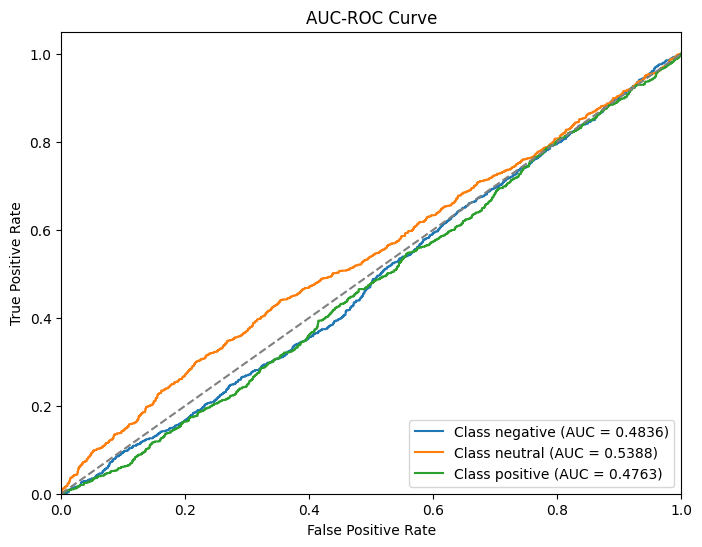

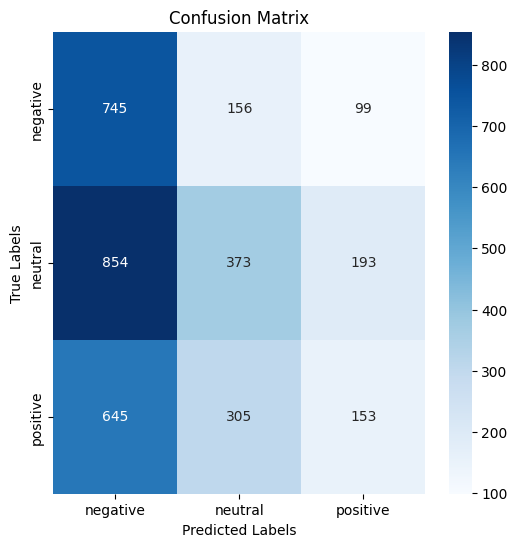

In [7]:

y_score = []
for score_dict in y_scores:
    row = [score_dict.get(cls, -1000) for cls in range(len(le.classes_))]
    y_score.append(row)

y_score = np.array(y_score)

#  inf, -inf, nan 
y_score = np.nan_to_num(y_score, nan=-1000.0, posinf=1000.0, neginf=-1000.0)


visualize.plot_roc_auc(filtered_y_test, y_score, le.classes_)
visualize.plot_confusion_matrix(filtered_y_test, y_pred, le.classes_)


## Hyperparameter Tuning: Selecting the Best Number of Hidden States (n_components)

In this section, we train multiple HMMs for each class using different numbers of hidden states (n_components).  
We evaluate each model based on the log-likelihood score and select the best-performing model for each class.


In [8]:
from sklearn.metrics import accuracy_score
from collections import defaultdict
import numpy as np

best_n = 0
best_acc = 0
best_model = None
best_y_pred = None
best_y_scores = None

for n_components in range(2, 11):  
    print(f"Number of components = {n_components}")
    
    
    class_hmms = {}
    for label in np.unique(train_labels):
        class_sequences = [seq for seq, l in zip(X_train_sequences, train_labels) if l == label]
        print(class_sequences)
        if len(class_sequences) < 2:
            continue  
        X = np.concatenate([np.array(seq).reshape(-1, 1) for seq in class_sequences])
        lengths = [len(seq) for seq in class_sequences]
        
        model = CategoricalHMM(n_components=n_components, n_iter=ITERATION, random_state=RANDOMSTATE)
        model.fit(X, lengths)
        class_hmms[label] = model
    
    # Predict on test set
    y_pred = []
    y_scores = []
    for tokens in tokenized_test:
        encoded = [vocab[token] for token in tokens if token in vocab]
        if len(encoded) < 2:
            continue

        seq = np.array(encoded).reshape(-1, 1)
        scores = {}
        for label, model in class_hmms.items():
            try:
                scores[label] = model.score(seq)
            except:
                scores[label] = -np.inf
        y_scores.append(scores)
        best_label = max(scores, key=scores.get) if scores else -1
        y_pred.append(best_label)

    
    acc = accuracy_score(filtered_y_test, y_pred)
    print(f"Accuracy = {acc:.4f} with number of components = {n_components}")
    
    
    if acc > best_acc:
        best_acc = acc
        best_n = n_components
        best_model = class_hmms
        best_y_pred = y_pred
        best_y_scores = y_scores

print(f"\n Best number of components: {best_n}, Accuracy = {best_acc:.4f}")


Number of components = 2
[[5, 7, 7, 7, 2, 5, 10, 1, 2, 11, 0, 5, 5, 2, 5, 10, 8, 2, 1, 0, 4, 9, 7], [12, 7, 5, 2, 12, 13, 14, 14, 15, 0, 8, 9], [0, 8, 16, 4, 3, 17, 0, 4, 18, 2, 14, 4, 10, 17, 4, 2, 10, 14, 7, 8, 4], [5, 7, 8, 2, 19, 7, 13, 14, 1, 8, 16, 2, 6, 13, 16, 2, 3, 4, 14, 4, 10, 5, 4, 2, 10, 14, 3, 4, 10, 1, 15, 2, 12, 7, 13, 9, 20, 16], [5, 20, 10, 3, 6, 0, 4, 2, 3, 13, 8, 8, 0, 8, 9, 2, 1, 10, 8, 9, 4, 3, 7, 13, 5, 14, 15, 2, 14, 7, 18, 2, 0, 8, 24], [18, 10, 8, 16, 2, 9, 7, 2, 11, 13, 5, 0, 19, 2, 16, 7, 8, 0, 9, 20, 16, 2, 14, 7, 5, 16, 2, 17, 7, 0, 19, 4], [13, 20, 2, 7, 20, 2, 5, 13, 8, 12, 13, 3, 8, 4, 1], [5, 7, 24, 2, 16, 3, 15, 0, 8, 9, 2, 6, 14, 7, 16, 2, 10, 14, 16, 4, 3, 8, 10, 16, 0, 17, 4, 2, 5, 6, 4, 10, 24, 2, 5, 0, 9, 20], [0, 17, 4, 2, 5, 0, 19, 24, 2, 6, 10, 5, 16, 2, 1, 10, 15, 2, 16, 20, 13, 5, 2, 20, 10, 0, 3, 2, 14, 7, 7, 24, 2, 18, 0, 4, 3, 1, 2, 1, 0, 1, 8, 16, 2, 20, 10, 16, 2, 18, 7, 13, 14, 1, 2, 14, 7, 7, 24, 2, 20, 16, 16, 6, 16, 0, 8, 15, 13, 3,

## Evaluate performance & Visualization after tuning

Accuracy: 0.4433721260289526
Classification Report:
              precision    recall  f1-score   support

    negative       0.41      0.54      0.46      1000
     neutral       0.48      0.31      0.38      1420
    positive       0.45      0.53      0.49      1103

    accuracy                           0.44      3523
   macro avg       0.45      0.46      0.44      3523
weighted avg       0.45      0.44      0.44      3523



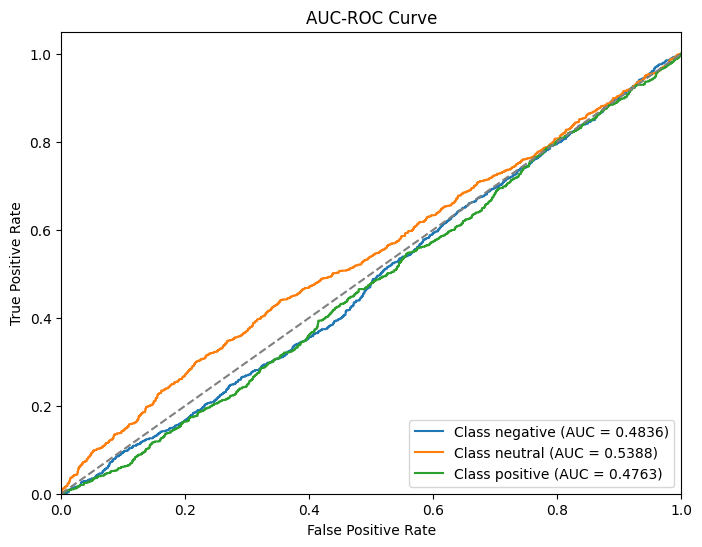

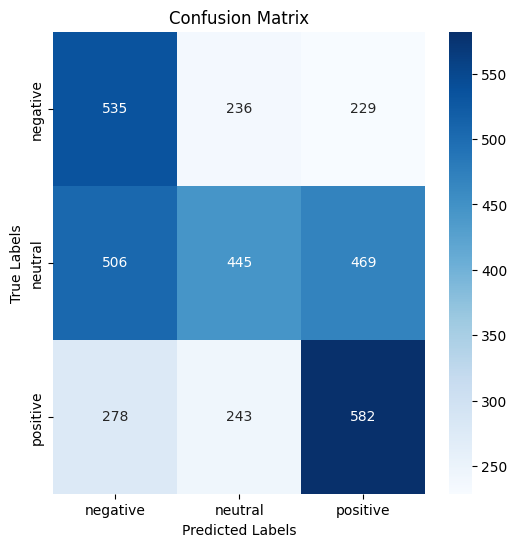

In [9]:
print("Accuracy:", accuracy_score(filtered_y_test, best_y_pred))
print("Classification Report:")
print(classification_report(filtered_y_test, best_y_pred, target_names=le.classes_))

best_y_score = []
for score_dict in best_y_scores:
    row = [score_dict.get(cls, -1000) for cls in range(len(le.classes_))]
    best_y_score.append(row)

best_y_score = np.array(y_score)

#  inf, -inf, nan 
best_y_score = np.nan_to_num(y_score, nan=-1000.0, posinf=1000.0, neginf=-1000.0)

visualize.plot_roc_auc(filtered_y_test, best_y_score, le.classes_)
visualize.plot_confusion_matrix(filtered_y_test, best_y_pred, le.classes_)